In [ ]:
#SOCIAL NETWORK ANALYSIS

In [131]:

import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

In [132]:
type_dict = {'user.id_str' : 'str'}  
#importazione del file esportato, per il quale specifichiamo la tipologia di alcuni campi
interjuve=pd.read_csv("C:/Users/aless/OneDrive/Desktop/AleBicocca/Data Science/Anno 2/Social Media Analytics/progetto/interjuve.csv", dtype = type_dict)


In [133]:
interjuve.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'created_at', 'id', 'id_str', 'text',
       'retweeted_status', 'retweet_count', 'user.id_str', 'user.screen_name',
       'user.location', 'lang', 'entities.hashtags', 'entities.user_mentions'],
      dtype='object')

In [134]:
interjuve=interjuve.drop('Unnamed: 0', axis=1)
interjuve=interjuve.drop('Unnamed: 0.1', axis=1)
interjuve

,created_at,id,id_str,text,retweeted_status,retweet_count,user.id_str,user.screen_name,user.location,lang,entities.hashtags,entities.user_mentions
0,2021-01-17 22:59:59,1350940961627656195,1350940961627656195,RT @DarmianOfficial: Grande prova di squadra! ...,Status(_api=<tweepy.api.API object at 0x7f05d4...,254,389547763,AliceMairo,"Richmond, London",it,"[{'text': 'Inter', 'indices': [61, 67]}, {'tex...","[{'screen_name': 'DarmianOfficial', 'name': 'M..."
1,2021-01-17 22:59:59,1350940960998494209,1350940960998494209,RT @Inter: 👏 | FINITAAAA!!!\n\nPartita dominat...,Status(_api=<tweepy.api.API object at 0x7f05d4...,1730,1121570085888516096,edEr99865,Harvard come soldattto elliott,it,"[{'text': 'InterJuventus', 'indices': [79, 93]...","[{'screen_name': 'Inter', 'name': 'Inter', 'id..."
2,2021-01-17 22:59:57,1350940955751424004,1350940955751424004,RT @LGWsport: Lukaku contro Chiellini... oggi....,Status(_api=<tweepy.api.API object at 0x7f05d4...,5,58391616,geppetto23,NaN,it,"[{'text': 'InterJuventus', 'indices': [47, 61]}]","[{'screen_name': 'LGWsport', 'name': 'Louis Gi..."
3,2021-01-17 22:59:57,1350940952941240327,1350940952941240327,"RT @juventusfc: 51' | Raddoppio dell'Inter, co...",Status(_api=<tweepy.api.API object at 0x7f05d4...,146,1327314775,conteOliviero,"Milano, zona Cesarini",it,"[{'text': 'InterJuve', 'indices': [58, 68]}]","[{'screen_name': 'juventusfc', 'name': 'Juvent..."
4,2021-01-17 22:59:56,1350940950554619909,1350940950554619909,Buonanotte tifosi nerazzurri !!! #InterJuventu...,None,1,269387968,Gianlucaimpa,Profilo ufficiale,it,"[{'text': 'InterJuventus', 'indices': [33, 47]}]",[]
...,...,...,...,...,...,...,...,...,...,...,...,...
30748,2021-01-17 17:45:51,1350861909373964288,1350861909373964288,Esatto @SerieA @juventusfc #Juventus #FinoAlla...,None,0,774502888387252224,leonida43725055,NaN,it,"[{'text': 'Juventus', 'indices': [27, 36]}, {'...","[{'screen_name': 'SerieA', 'name': 'Lega Serie..."
30749,2021-01-17 17:45:46,1350861888113037313,1350861888113037313,#InterJuve \nche gioia 🤩🤩 senza #lajoya\nremem...,None,0,1261960996979200000,DiegoRaimondi11,NaN,it,"[{'text': 'InterJuve', 'indices': [0, 10]}, {'...",[]
30750,2021-01-17 17:45:31,1350861824258953217,1350861824258953217,RT @Linerazzurra: #InterJuventus\nRom...pensac...,Status(_api=<tweepy.api.API object at 0x7f05d4...,5,1316774107183185920,prettyboilello,NaN,it,"[{'text': 'InterJuventus', 'indices': [18, 32]}]","[{'screen_name': 'Linerazzurra', 'name': 'Lici..."
30751,2021-01-17 17:45:27,1350861808299630594,1350861808299630594,RT @OptaPaolo: 27 - Questa sarà la sfida tra d...,Status(_api=<tweepy.api.API object at 0x7f05d4...,6,179662473,tizianacairati,Italia,it,"[{'text': 'Lukaku', 'indices': [102, 109]}]","[{'screen_name': 'OptaPaolo', 'name': 'OptaPao..."


In [135]:
import re  #funzione finalizzata alla tokenizzazione mediante espressioni regolari
 
emoticons_str = r"""
    (?:
        [:=;] # Eyes
        [oO\-]? # Nose (optional)
        [D\)\]\(\]/\\OpP] # Mouth
    )"""
 
regex_str = [
    emoticons_str,
    r'<[^>]+>', # HTML tags
    r'(?:@[\w_]+)', # @-mentions
    r"(?:\#+[\w_]+[\w\'\-]*[\w]+)", # hash-tags
    r'http[s]?://(?:[a-z]|[0-9]|[$-_@.&amp;+]|[!*\(\),]|(?:%[0-9a-f][0-9a-f]))+', # URLs
 
    r'(?:(?:\d+,?)+(?:\.?\d+)?)', # numbers
    r"(?:[a-z][a-z'\-_]+[a-z])", # words with - and '
    r'(?:[\w_]+)', # other words
    r'(?:\S)' # anything else
]
    
tokens_re = re.compile(r'('+'|'.join(regex_str)+')', re.VERBOSE | re.IGNORECASE)
emoticon_re = re.compile(r'^'+emoticons_str+'$', re.VERBOSE | re.IGNORECASE)
 
def tokenize(s):
    return tokens_re.findall(s)
 
def preprocess(s, lowercase=False):
    tokens = tokenize(s)
    if lowercase:
        tokens = [token if emoticon_re.search(token) else token.lower() for token in tokens]
    return tokens

In [136]:
#etichettiamo user pro-inter, pro-juve e neutri, rappresentandoli successivamente a mano sul grafico della rete

tifo=[]
for index,row in interjuve.iterrows():
    count=0
    if row['retweeted_status']!= 'None':
        pre=preprocess(row['text'])
        if any(x in pre for x in ['#FORZAINTER','🔵','🐍','FINITAAAA','@Inter','#JuveMerd4']):
            if count==0:
                tifo.append('Pro-Inter')
                count+=1
        elif any(x in pre for x in ['#ForzaJuve','⚪','#FinoAllaFine','@juventusfc','#anala']) :
            if count==0:
                tifo.append('Pro-Juve')
                count+=1
        else:
            tifo.append('Neutro')
            
            
    else:
        pre=preprocess(row['retweeted_status'])
        if any(x in pre for x in ['#FORZAINTER','🔵','🐍','FINITAAAA','@Inter','#JuveMerd4']):
            if count==0:
                tifo.append('Pro-Inter')
                count+=1
        elif any(x in pre for x in ['#ForzaJuve','⚪','#FinoAllaFine','@juventusfc','#anala']):
            if count==0:
                tifo.append('Pro-Juve')
                count+=1
        else:
            tifo.append('Neutro')
        
        
len(tifo)
        

        
    

30753

In [137]:
interjuve['tifo']=tifo
#inseriamo la colonna 'tifo' al dataset iniziale

In [138]:
#RETE CON USER DEL RETWEET CHE PUNTA VERSO USER CHE HA CREATO IL TWEET RETWETATO 
#analizziamo il tempo della partita e i primi 20 minuti del postpartita
interjuve=interjuve[interjuve['created_at'] > "2021-01-17 19:45:00"] #orario UTC
interjuve=interjuve[interjuve['created_at'] < "2021-01-17 22:00:00"]
interjuve=interjuve[interjuve['lang']=='it'] #di lingua italiana, che sono la maggiorparte
interjuve


,created_at,id,id_str,text,retweeted_status,retweet_count,user.id_str,user.screen_name,user.location,lang,entities.hashtags,entities.user_mentions,tifo
6293,2021-01-17 21:59:59,1350925864033267713,1350925864033267713,RT @EmeParonzini: Molto difficile giocare senz...,Status(_api=<tweepy.api.API object at 0x7f05d4...,2,2517915133,matteo_nelli,Italia,it,"[{'text': 'InterJuve', 'indices': [96, 106]}]","[{'screen_name': 'EmeParonzini', 'name': 'Emer...",Neutro
6294,2021-01-17 21:59:59,1350925862665908230,1350925862665908230,@Cristiano che batte l’angolo veloce con @mila...,None,0,481414577,alessandrogio15,"Roma, Lazio",it,[],"[{'screen_name': 'Cristiano', 'name': 'Cristia...",Neutro
6295,2021-01-17 21:59:59,1350925862238085125,1350925862238085125,Questa partita al netto della pessima prestazi...,None,0,1093263617913487366,frabru95,NaN,it,[],[],Neutro
6296,2021-01-17 21:59:58,1350925861139193856,1350925861139193856,"Partita buona, per 10 minuti. Poi abbiamo infi...",None,0,600065517,ilventocontro,NaN,it,[],[],Neutro
6297,2021-01-17 21:59:58,1350925858735841280,1350925858735841280,Ma la Juventus non doveva vincere lo scudetto?...,None,0,969194163169263616,Impresa_Energy,NaN,it,"[{'text': 'InterJuve', 'indices': [48, 58]}]",[],Neutro
...,...,...,...,...,...,...,...,...,...,...,...,...,...
27108,2021-01-17 19:45:03,1350891905123495941,1350891905123495941,RT @PresMoratti: Dopo quello che ho visto caro...,Status(_api=<tweepy.api.API object at 0x7f05d4...,47,3323364562,paoli596,"Lombardia, Italia",it,"[{'text': 'Vidal', 'indices': [54, 60]}]","[{'screen_name': 'PresMoratti', 'name': 'Massi...",Neutro
27109,2021-01-17 19:45:03,1350891904750276613,1350891904750276613,RT @PeppinInter: Vi chiedo solo di sudare la m...,Status(_api=<tweepy.api.API object at 0x7f05d4...,7,1224330951326621697,Alfredo53631909,"Cagliari, Sardegna",it,[],"[{'screen_name': 'PeppinInter', 'name': 'Peppi...",Neutro
27110,2021-01-17 19:45:02,1350891903743569922,1350891903743569922,RT @LapoDeCarlo1: #Vidal e il bacio allo stemm...,Status(_api=<tweepy.api.API object at 0x7f05d4...,71,772447625836687361,poetanaif,"Firenze, Toscana",it,"[{'text': 'Vidal', 'indices': [18, 24]}, {'tex...","[{'screen_name': 'LapoDeCarlo1', 'name': 'Lapo...",Neutro
27111,2021-01-17 19:45:02,1350891901197688833,1350891901197688833,RT @LapoDeCarlo1: #Vidal e il bacio allo stemm...,Status(_api=<tweepy.api.API object at 0x7f05d4...,71,927399679,melotuitto,"Milano, Lombardia",it,"[{'text': 'Vidal', 'indices': [18, 24]}, {'tex...","[{'screen_name': 'LapoDeCarlo1', 'name': 'Lapo...",Neutro


In [139]:
retweets=interjuve[interjuve['retweeted_status'] != 'None']  
retweets_f=retweets[['user.id_str','retweeted_status','tifo']]
retweets_f

,user.id_str,retweeted_status,tifo
6293,2517915133,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro
6300,896133298593943553,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro
6301,221677701,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro
6302,444612700,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro
6303,745444021,Status(_api=<tweepy.api.API object at 0x7f05d4...,Pro-Inter
...,...,...,...
27108,3323364562,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro
27109,1224330951326621697,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro
27110,772447625836687361,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro
27111,927399679,Status(_api=<tweepy.api.API object at 0x7f05d4...,Neutro


In [140]:
#in questo blocco di codice si cerca di estrarre dal campo retweeted_status l'id dell'utente del tweet retwettato
user_id_ret=[]
li=retweets_f['retweeted_status'].values.tolist()
for el in li:
    mystring =  el
    keyword = '\'user\': {\'id\': '
    before_keyword, keyword, after_keyword = mystring.partition(keyword)
    ak=after_keyword
    keyword_2=','
    before_keyword_2, keyword_2, after_keyword_2 = ak.partition(keyword_2) 
    user_id_ret.append(before_keyword_2)

len(user_id_ret)  

6856

In [141]:
retweets_f['user_id_ret']=user_id_ret
retweets_f=retweets_f.drop('retweeted_status',axis=1) 
retweets_f=retweets_f.groupby(retweets_f.columns.tolist(),as_index=False).size().reset_index()
retweets_f.columns=['user.id_str','tifo','user_id_ret','weight']
retweets_f

C:\Users\aless\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,user.id_str,tifo,user_id_ret,weight
0,1000058701225582592,Neutro,1336746906,1
1,1000058701225582592,Neutro,270920070,1
2,1000058701225582592,Neutro,4099609246,1
3,1000058701225582592,Neutro,481011843,1
4,1000081387460988928,Neutro,491699259,1
...,...,...,...,...
5902,999269749,Pro-Juve,253508662,1
5903,999423002,Neutro,2504382559,1
5904,999423002,Neutro,2544005815,1
5905,999596295525453824,Neutro,1086700214,1


In [142]:
sorted(list(retweets_f['weight']))[::-1][0:10] #weights più alti

[26, 20, 19, 19, 19, 18, 18, 15, 14, 14]

In [143]:
user_ret_network= nx.DiGraph()
for index,row in retweets_f.iterrows():
    user_ret_network.add_edge(row['user.id_str'],row['user_id_ret'],weight=row['weight']) #costruiamo la network pesata
#il peso dipende dal numero di volte che un user retwetta un post di un altro user
#peso maggiore avvicina il nodo al nodo ritwittato piu volte

In [144]:
#community detection

In [145]:
adj=nx.adjacency_matrix(user_ret_network,weight='weight')
#fornisco la matrice diadiacenza che mi dice se un nodo è adiacente ad un altro o meno e la passo al kmeans
#community detection basata su node similarity, usata per reti enormi e per esigenze pratiche

In [146]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3, random_state=0).fit(adj)
#3 cluster perchè voglio confrontare come detecta le communities inter juve e neutro rispetto al metodo manuale 
#cerchiamo communities per coloro che ritwettano

In [147]:
km=list(kmeans.labels_)
len(km) #passo i valori al posto dei colori della rete
#km è una lista composta da 0,1,2 a seconda che il nodo considerato sia appartenete alla community 1,2 o 3

4747

In [148]:
zero=0
for el in km:
    if el==0:
        zero+=1
#2 giallo
#0 viola
uno=0
for el in km:
    if el==1:
        uno+=1
due=0
for el in km:
    if el==2:
        due+=1
display(zero, uno, due)
#si evidenziano i risultati dei 3 count relativi alle 3 communities
#coloreremo di nero la prima communities
#coloreremo di rosso la seconda community
#coloreremo di blu la terza community
#verdi saranno coloro che sono stati solo ritwittati, senza aver ritwittato

3452

7

1288

In [149]:
ret_id=list(retweets_f['user.id_str'])
au=[]

for node in user_ret_network:
    if node not in ret_id:
        au.append(0) #no
    else:
        au.append(1) #yes

        
len(au)

#codice utile a capire chi non ha effettuato ritweet, venendo solo ritwittato di fatto (colore verde nel grafico)  

4747

In [150]:

color_map =[]
count=-1
for el in km:
    count+=1
    if au[count] == 0: #coloriamo di verde chi non ha effettuato ritweet
        color_map.append('green')
    else:
        if el == 1:
            color_map.append('red')
        if el == 0:
            color_map.append('black')
        if el == 2:
            color_map.append('blue')
len(color_map)

4747

In [151]:
#dizionario labels per grafico. cerchiamo gli screen name di coloro che hanno ottenuto piu di 50 retweet all'interno della rete
nodes_list= list(user_ret_network.nodes())
d=dict(user_ret_network.in_degree())
for key in d:
    if d[key]<62:
        d[key]=''
    else:
        u=api.get_user(key)
        d[key]=u.screen_name

In [152]:
node_big = []  #per ingrandire gli users che hanno ottenuto più di 50 retweet (influencer)
for node in user_ret_network:
    if user_ret_network.in_degree(node) >= 62:
        node_big.append(10000)
    else: 
        node_big.append(100)      
len(node_big)

4747

Name: 
Type: DiGraph
Number of nodes: 4747
Number of edges: 5887
Average in degree:   1.2402
Average out degree:   1.2402


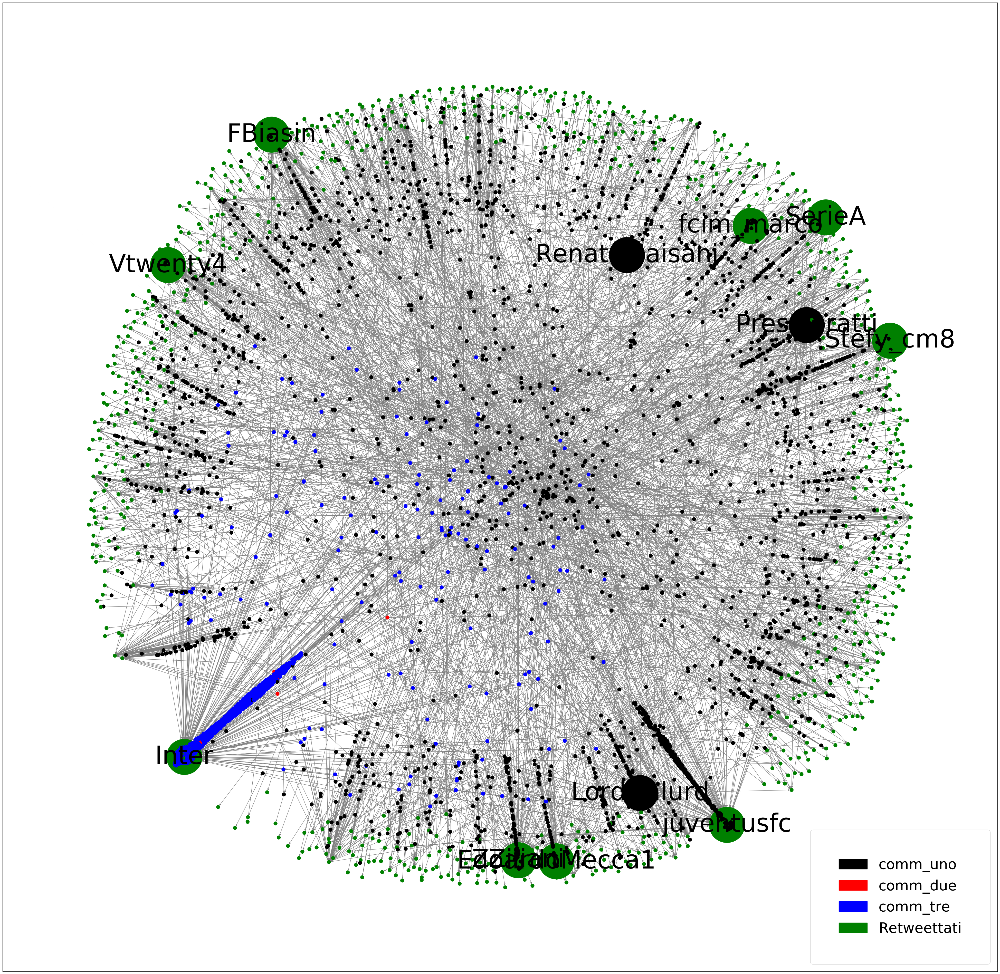

In [153]:
print(nx.info(user_ret_network)) #da qui estraiamo order e size e commento
plt.figure(figsize =(50,50), dpi=100)
nx.draw_networkx(user_ret_network,with_labels=True, node_color=color_map, labels = d, font_size=70, node_size=node_big, edge_color='grey')

import matplotlib.patches as mpatches

black_patch = mpatches.Patch(color='black', label='comm_uno')
red_patch = mpatches.Patch(color='red', label='comm_due')
blue_patch = mpatches.Patch(color='blue', label='comm_tre')
green_patch = mpatches.Patch(color='green', label='Retweettati')
plt.legend(handles=[black_patch,red_patch,blue_patch,green_patch], loc='lower right', borderpad=2,prop={'size':40})

In [ ]:
#il k-means ci aiuta a distiguere una comunità intorno all'account relativo all'Inter
#qualche nodo rosso tra Inter e juventus, potrebbe trattarsi di users che hanno ritweettato la juventus, anche se sono pochi
#una forte comunità di users non schierati probabilmente

#sfruttiamo questa attività di community detection per determinare in maniera migliore come si discribuiscono gli utenti nella rete
#dei retweet.
#si cerca quindi di scovare anche manualmente le comunità

In [154]:
#ret_id=list(retweets_f['user.id_str']) 
tifosi=list(retweets_f['tifo'])
#creiamo due liste ausiliarie per facilitare il lavoro di colorazione della rete ed ingrandimento degli influencer

In [155]:
#coloriamo di:
#nero i retwittanti di tifo neutro
#rosa i retwittanti di tifo pro-juve
#blu i retwittanti di tifo pro-inter
#verde i retwittati che non ritweettano

color_map = []
for node in user_ret_network:
    if node in ret_id:
        index=ret_id.index(node,0,len(ret_id))
        if tifosi[index] == 'Pro-Inter':
            color_map.append('blue')
        if tifosi[index] == 'Pro-Juve': 
            color_map.append('red') 
        if tifosi[index] == 'Neutro':
            color_map.append('black')
    else:
        color_map.append('green')  
len(color_map)

4747

In [156]:
inter=0
juve=0
neutri=0
for el in color_map:
    if el == 'blue':
        inter+=1
    if el == 'red':
        juve+=1
    if el == 'black':
        neutri+=1
display(inter, juve, neutri)

1234

418

2282

Name: 
Type: DiGraph
Number of nodes: 4747
Number of edges: 5887
Average in degree:   1.2402
Average out degree:   1.2402


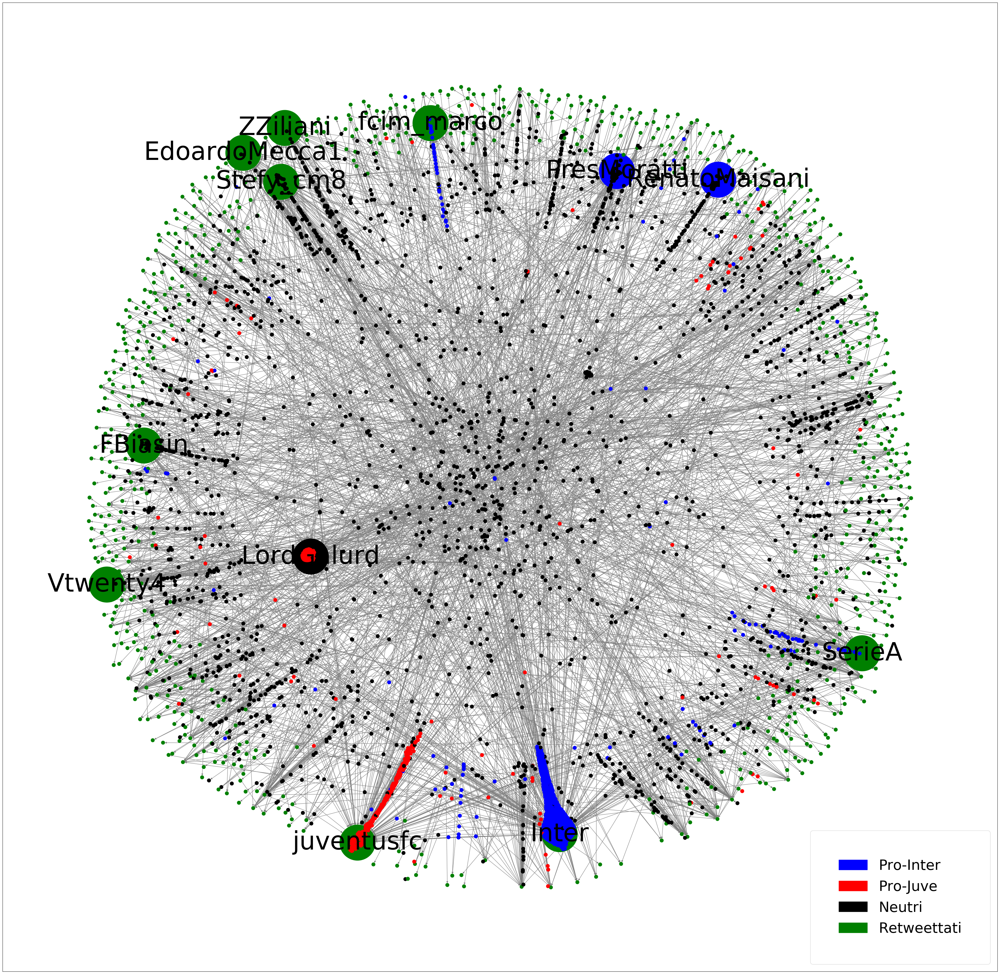

In [157]:
print(nx.info(user_ret_network)) #da qui estraiamo order e size e commento
plt.figure(figsize =(50,50), dpi=100)
nx.draw_networkx(user_ret_network,with_labels=True, node_color=color_map, labels = d, font_size=70, node_size=node_big, edge_color='grey')

import matplotlib.patches as mpatches
blue_patch = mpatches.Patch(color='blue', label='Pro-Inter')
red_patch = mpatches.Patch(color='red', label='Pro-Juve')
black_patch = mpatches.Patch(color='black', label='Neutri')
green_patch = mpatches.Patch(color='green', label='Retweettati')
plt.legend(handles=[blue_patch,red_patch,black_patch,green_patch], loc='lower right', borderpad=2,prop={'size':40})


In [158]:
#confronto numerico tra communities:

col=['Neutri','Pro-Juve','Pro-Inter']
row=['2282', '418','1234']
com_1=pd.DataFrame(row,col)
com_1.T

,Neutri,Pro-Juve,Pro-Inter
0,2282,418,1234


In [159]:
col=['comm_uno','comm_due','comm_tre']
row=['3452', '7','1288']
com_2=pd.DataFrame(row,col)
com_2.T

,comm_uno,comm_due,comm_tre
0,3452,7,1288


In [ ]:
#SNA SOCIAL NETWORK ANALYSIS

In [ ]:
#ASSORTATIVITY

#misura di connessione, omofilia

#la rete sembra essere disassortativa, il che significa che gli influencer tendono ad associarsi a nodi di grado piccolo
#valori tra -1 e 1
# ha senso perchè la maggior parte dei singoli si lega ai 10 influencer

#gli influencers si legano ai nodi di grado minore in una rete disassortativa

In [160]:
r = nx.degree_assortativity_coefficient(user_ret_network)
print(f"{r:3.1f}")

-0.3


In [161]:
#misure di distribuzione

from networkx import density
round(density(user_ret_network),5)



0.00026

In [162]:
#node_connectivity
node_c=nx.node_connectivity(user_ret_network)

In [163]:
#Connectivity measures the minimum number of elements (vertices or edges) that must be removed to disconnect the graph
edge_c=nx.edge_connectivity(user_ret_network)

In [164]:
#dai valori di connettività si evince che siamo in presenza di un grafico disconnesso
#il che è comprensibile dal momento che molti utenti effettuano un retweet senza essere ritwittati

In [165]:
#raggio :Minimum eccentricity in the graph. Eccentricity= Maximum distance of the vertex from any other vertex
#raggio uguale a 1 quindi nella rete


In [166]:
#misura di quanto gli utenti si scambino i retweet: molto bassa dal momento che la maggior parte delle persone ritwittano
#gli influencer, ma gli influencer non ritwittano i singoli nodi
overall_reciprocity=round(nx.overall_reciprocity(user_ret_network),3)

In [167]:
#caratteristiche della rete:
#dataframe di riassunto: print network, density, assortativity
name=['type','n_nodes','n_edges','avg_indeg','avg_outdeg','assortativity','density']
info=['DiGraph','4747','5887','1.24','1.24','-0.3','0.0003']
net_info=pd.DataFrame(info,name)
net_info.T

,type,n_nodes,n_edges,avg_indeg,avg_outdeg,assortativity,density
0,DiGraph,4747,5887,1.24,1.24,-0.3,0.0003


In [168]:
#caratteristiche della rete:
#dataframe di riassunto: print network, density, assortativity
name=['radius','node_connectivity','edge_connectivity','overall_reciprocity']
info=['1','0','0',overall_reciprocity]
net_info=pd.DataFrame(info,name)
net_info.T

,radius,node_connectivity,edge_connectivity,overall_reciprocity
0,1,0,0,0.002


In [169]:
#commenti alla tabella e alla rete:

#ego-centric network
#preferential attachment: poca connessione tra i nodi e tanti nodi con basso grado
#media gradi entrata e uscita uguali. media influenzata dal fatto che la maggior parte degli utenti hanno gradi minori uguali a 1
#logicamente la density è molto vicina a zero, dato che il grafico non è molto interconnesso. Sparsity elevata


In [29]:
#MISURE DI CENTRALITA'


In [170]:
#degree_centrality_in
#centr_degree sono normalizzate automaticamente

#cerchiamo chi sono i 10 con il grado piu alto di in_degree, per vedere dunque chi sono i piu ritwettati

from networkx import in_degree_centrality
in_deg=in_degree_centrality(user_ret_network)
in_deg_sort=dict(sorted(in_deg.items(), key=lambda item: item[1], reverse= True))
list_degin =list(in_deg_sort.values())[0:10] #ottengo i primi 10 valori 
list_degin=[round(num,3) for num in list_degin]

deg_in=sorted([user_ret_network.in_degree(n) for n in user_ret_network.nodes()])
deg_in=deg_in[-11:-1] #top 10 per retweet lista
deg_in=deg_in[::-1]


us=[]
hubs=[]
count=0
for key in in_deg_sort:  #ottengo gli screen name
    count+=1
    if count<11:
        hubs.append(key)
        u=api.get_user(key).screen_name
        us.append(u)

#unisco tutto in un dataframe

cen_deg_in=pd.DataFrame(list(zip(us, deg_in, list_degin)), columns = ['user_screen_name','node_indegree','cen_indegree'])
cen_deg_in
        


,user_screen_name,node_indegree,cen_indegree
0,Inter,386,0.273
1,juventusfc,121,0.081
2,Stefy_cm8,101,0.025
3,ZZiliani,99,0.021
4,FBiasin,84,0.021
5,PresMoratti,80,0.018
6,LordGalurd,79,0.017
7,EdoardoMecca1,77,0.017
8,SerieA,65,0.016
9,fcim_marco,62,0.014


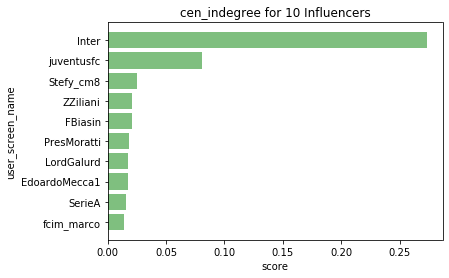

In [171]:
objects = cen_deg_in['user_screen_name'][::-1]
performance= cen_deg_in['cen_indegree'][::-1]
y_pos = np.arange(len(objects))
 
plt.barh(objects, performance, align='center', alpha=0.5, color='green')
plt.ylabel('user_screen_name')
plt.xlabel('score')
plt.title('cen_indegree for 10 Influencers')
plt.show()




In [172]:
#degree_centrality_out

#cerchiamo chi sono i 10 con il grado piu alto di out_degree, per vedere dunque chi sono gli user che ritwittano di piu

from networkx import out_degree_centrality
out_deg=out_degree_centrality(user_ret_network)
out_deg_sort=dict(sorted(out_deg.items(), key=lambda item: item[1], reverse= True))
    
list_degout =list(out_deg_sort.values())[0:5] #ottengo i primi 10 valori 
list_degout=[round(num,3) for num in list_degout]
deg_out=sorted([user_ret_network.out_degree(n) for n in user_ret_network.nodes()])
deg_out=deg_out[-6:-1] #top 10 per retweet lista
deg_out=deg_out[::-1]


us=[]
count=0
for key in out_deg_sort:  #ottengo gli screen name
    count+=1
    if count<6:
        u=api.get_user(key).screen_name
        us.append(u)

#unisco tutto in un dataframe

cen_deg_out=pd.DataFrame(list(zip(us, deg_out, list_degout)), columns = ['user_screen_name','node_outdegree','cen_outdegree'])
cen_deg_out

#valore molto basso dato dalla nostra tipologia di rete
#ci accorgiamo che non ci sono stati spam

,user_screen_name,node_outdegree,cen_outdegree
0,Salvato95551627,22,0.005
1,LuciLuci78,19,0.005
2,AleGobbo87,18,0.004
3,alecardi7,17,0.004
4,sindelar3,16,0.004


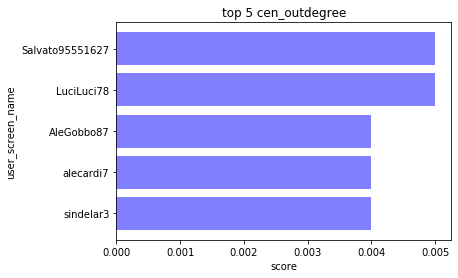

In [173]:
objects = cen_deg_out['user_screen_name'][::-1]
performance= cen_deg_out['cen_outdegree'][::-1]
y_pos = np.arange(len(objects))
 
plt.barh(objects, performance, align='center', alpha=0.5, color='blue')
plt.ylabel('user_screen_name')
plt.xlabel('score')
plt.title('top 5 cen_outdegree')
plt.show()

In [174]:
from networkx import closeness_centrality


#closeness_centrality

#Closeness Centrality misura la vicinanza di un nodo a tutti gli altri nodi di una rete,
#non solo quelli a cui è direttamente collegato.

#reciproco della somma della distanza di un nodo da tutti gli altri nodi del grafo
#misura automaticamente normalizzata

#logicamente i vincitori sono inter e juve, le quali sono le maggiormente ritwittate direttamente

close_cen=closeness_centrality(user_ret_network)
close_cen_sort=dict(sorted(close_cen.items(), key=lambda item: item[1], reverse= True))
list_close =list(close_cen_sort.values())[0:5] #ottengo i primi 10 valori 
list_close=[round(num,3) for num in list_close]

us=[]
count=0
for key in close_cen_sort:  #ottengo gli screen name
    count+=1
    if count<6:
        u=api.get_user(key).screen_name
        us.append(u)

#unisco tutto in un dataframe

cen_close=pd.DataFrame(list(zip(us,list_close)), columns = ['user_screen_name','cen_close'])
cen_close

,user_screen_name,cen_close
0,Inter,0.273
1,juventusfc,0.084
2,Stefy_cm8,0.024
3,EdoardoMecca1,0.023
4,ZZiliani,0.022


In [175]:

from networkx import betweenness_centrality


#betweeness_centrality norm
#Centrality misura l’importanza di un nodo nelle «comunicazioni» con gli altri nodi e
#quindi l’ influenza all'interno di una rete in virtù del «controllo sulle informazioni» che passano,
#pertanto si riferisce a quanto un nodo sia di passaggio .

#nella nostra rete l'informazione non fluisce più di troopo, infatti è abbastanza diretta come dimostra la betweenness



bet_cen=betweenness_centrality(user_ret_network, normalized=True)
bet_cen_sort=dict(sorted(bet_cen.items(), key=lambda item: item[1], reverse= True))
list_bet =list(bet_cen_sort.values())[0:5] #ottengo i primi 10 valori 
list_bet=[round(num,6) for num in list_bet]

us=[]
count=0
for key in bet_cen_sort:  #ottengo gli screen name
    count+=1
    if count<6:
        u=api.get_user(key).screen_name
        us.append(u)

#unisco tutto in un dataframe

bet_close=pd.DataFrame(list(zip(us, list_bet)), columns = ['user_screen_name','cen_bet'])
bet_close

,user_screen_name,cen_bet
0,juvemyheart,0.000024
1,GiAdUzZoLa90,0.000016
2,LordGalurd,0.000007
3,_grazy87,0.000006
4,Upupa234,0.000004


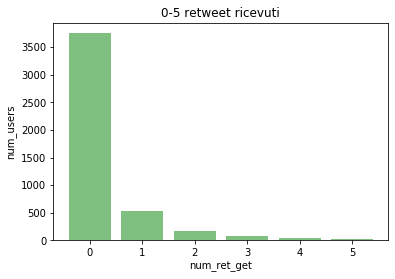

In [176]:
#produciamo un barchart per valutare quanti utenti hanno ricevuto pochi retweets, pari ad un numero minore di 5

objects = ('0','1','2','3','4','5')
degrees = sorted([user_ret_network.in_degree(n) for n in user_ret_network.nodes()])

uno=0
due=0
tre=0
qua=0
cin=0
zer=0
for el in degrees:
    if el == 0:
        zer+=1
    if el == 1:
        uno+=1
    if el == 2:
        due+=1
    if el == 3:
        tre+=1
    if el == 4:
        qua+=1
    if el == 5:
        cin+=1
        
performance=[]
performance.append(zer)
performance.append(uno)
performance.append(due)
performance.append(tre)
performance.append(qua)
performance.append(cin)

y_pos = np.arange(len(objects))
 
plt.bar(y_pos, performance, align='center', alpha=0.5, color='green')
plt.xticks(y_pos, objects)
plt.ylabel('num_users')
plt.xlabel('num_ret_get')
plt.title('0-5 retweet ricevuti')
plt.show()



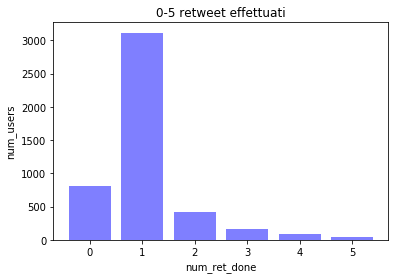

In [177]:
#produciamo un barchart per valutare quanti utenti hanno ricevuto pochi retweets, pari ad un numero minore di 5

objects = ('0','1','2','3','4','5')
degrees = sorted([user_ret_network.out_degree(n) for n in user_ret_network.nodes()])

uno=0
due=0
tre=0
qua=0
cin=0
zer=0
for el in degrees:
    if el == 0:
        zer+=1
    if el == 1:
        uno+=1
    if el == 2:
        due+=1
    if el == 3:
        tre+=1
    if el == 4:
        qua+=1
    if el == 5:
        cin+=1
        
performance=[]
performance.append(zer)
performance.append(uno)
performance.append(due)
performance.append(tre)
performance.append(qua)
performance.append(cin)

y_pos = np.arange(len(objects))
 
plt.bar(y_pos, performance, align='center', alpha=0.5, color='blue')
plt.xticks(y_pos, objects)
plt.ylabel('num_users')
plt.xlabel('num_ret_done')
plt.title('0-5 retweet effettuati')
plt.show()

#si evince che la maggior parte degli utenti hanno effettuato un solo retweet

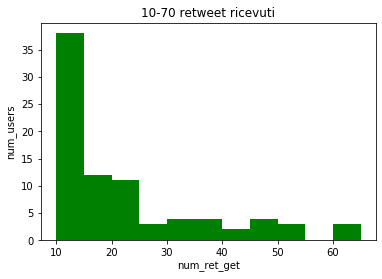

In [178]:
def plot_degree_dist(G):
    bins=np.arange(10,70,5)  
    degrees = sorted([G.in_degree(n) for n in G.nodes()])
    plt.hist(degrees, bins, color='green')
    plt.ylabel('num_users')
    plt.xlabel('num_ret_get')
    plt.title('10-70 retweet ricevuti')
    plt.show()
    #metti i labels

plot_degree_dist(user_ret_network)

#notiamo come il numero di retweet ricevuti cali drasticamente
#questo ci spinge a scegliere come soglia i 50 retweet per deterimnare un Hub, per un discorso di rarità

In [ ]:

#https://www.learndatasci.com/tutorials/k-means-clustering-algorithms-python-intro/
#https://developer.twitter.com/en/docs/twitter-api/v1